# **The Battle of Neighborhoods Capstone - Final Project**

<p align="center">
  <img width="460" height="300" src="https://foter.com/photos/395/bedroom-in-hotel.jpg">
</p>

Photo on Foter.com

## **Choosing an area to stay in Paris based on the experience of another one**

This note book provide an example on how to use [Foursquare API](https://foursquare.com/). 

It contains:

     1. A detailed description of business problem and discussion of the background
     2. A descriptions of data, its different sources and how it will solve the problem
     3. detailed methodology 
     4. Analysis of results, discussion and improvement recommendation
     5. Conclusion
     

## 1 Introduction and Discussion of the Business Objective and Problem¶


### The usual research of hotels or airbnb

#### What's the common point between below airbnb in Paris result :

<p align="center">
  <img width="460" height="300" src="https://github.com/Aymen-lng/Coursera_Capstone/blob/master/Capture5.PNG?raw=true">
</p>

#### and below google result for "Hotel Paris"

<p align="center">
  <img width="460" height="300" src="https://github.com/Aymen-lng/Coursera_Capstone/blob/master/Capture4.PNG?raw=true">
</p>

You get it....... ? Yes right! a total services/prices oriented results.   
What if you do not know anything about Paris different districts? Paris like New York, London or Berlin is a big, multicultural city with different life style depending on which district you are. You might be interested by an area with a lot of pubs and wine bar close to your place to avoid paying extra for a cab to go back to your place every nights. Or maybe, an calm area with a lot of green places and coffee shops to enjoy a nice view breakfast.  
So how would you choose ? I guess that you are doing like me:  
    * Or you anticipate by making researches on different districts of the city, and then choose them when booking your trip, taking the risk that no hotel or airbnb are available there.  
    * Or you search first on the best place based on prices and services proposed, then make additional researches on districts where the best results are. 
    * Or if you already been in Paris, based on you previous experience you just decide to stay on the same neighborhoods that was nice enough and don't take risk to check another one.

So the main problem is the missing informations about the different areas of a city when locking for your hotel or airbnb forcing you making different researches to just looking for a place to stay. 

### And what if...?

What if you could use a tool that shows different districts of a city based on its kind of venues and find the one that match the most with your trip mindset and shows it on a map with all airbnb and hotels present there.
Let's keep as example the city of Paris. This city is made up of 20 different districts named "arrondissement". All of them have particularities. Some are full of coffees, restaurants, others bars, others parks and museum. If it's your first trip in Paris, you can be totally lost.  
The request is: is it possible to build and use a machine learning method to train a model that will cluster all these districts based on the categories of each venues in the district (bar,pub,museum,park etc...), then, by defining what kind of trip you want, propose you the best district and shows it in a map of Paris with all hotels and airbnb geo-located?
We can, if you already know some interesting or not interesting neighborhoods, request to the tool a map that show you similar neighborhood to the one you know to help you on your choice. 

## 2 Data 

### 2.1 Data sources

To build this tool we will need following informations (you can click on links) :  

+ Paris district location. 20 different districts also known as "arrondissements" that will be used as cluster. We need their exact localization in order to map them. [Open Data Paris](https://opendata.paris.fr/explore/dataset/arrondissements/table/?dataChart)  
+ Venues categories and Hotel localization. By using this api we will get all the venues in each neighborhood : [Foursquare API](https://foursquare.com/)
+ Airbnb localization : [Open Data Paris](https://data.opendatasoft.com/explore/dataset/airbnb-averages%40public/export/?disjunctive.room_type&sort=date&refine.location=France,+Paris)

### 2.2 Data approach 

With Paris districts data, we will be able to localize and identified them in a map of Paris.  
Using Foursqure data, we will be able to analye all the diferente venues categories grouped by districts.  
FInaly with foursquare again and Airbnb open data, we will be able to identified the place to stay by district.

## 3 Methodology

### Step 1: Libraries import

In [1]:
!pip install beautifulsoup4
import numpy as np # library to handle data in a vectorized manner
import json # library to handle JSON files
import pandas as pd

!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
!conda install -c conda-forge folium=0.5.0 --yes 
import folium # map rendering library
from bs4 import BeautifulSoup

# Import k-means from clustering stage
from sklearn.cluster import KMeans



print('Libraries imported.')

     |████████████████████████████████| 122kB 24.1MB/s eta 0:00:01
Solving environment: done

## Package Plan ##

  environment location: /home/jupyterlab/conda/envs/python

  added / updated specs:
    - geopy


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    geographiclib-1.50         |             py_0          34 KB  conda-forge
    geopy-1.22.0               |     pyh9f0ad1d_0          63 KB  conda-forge
    ------------------------------------------------------------
                                           Total:          97 KB

The following NEW packages will be INSTALLED:

  geographiclib      conda-forge/noarch::geographiclib-1.50-py_0
  geopy              conda-forge/noarch::geopy-1.22.0-pyh9f0ad1d_0



geopy-1.22.0         | 63 KB     | ##################################### | 100% 
geographiclib-1.50   | 34 KB     | ##################################### | 100% 
Preparing tr

### Step 2: Data Analysis

#### Data cleaning and preparation

Paris diistricts data will be download from 'https://opendata.paris.fr/explore/dataset/arrondissements/table/?dataChart'  
Then upload into a github repository in order to get them avialable for this project.  
The format used is CSV

In [3]:
paris = pd.read_csv('https://raw.githubusercontent.com/Aymen-lng/Coursera_Capstone/master/Arrondissements%20(1).csv') #I upload my Data from y github raw depository
paris # now we can have a look on the dataframe

,N_SQ_AR,C_AR,C_ARINSEE,L_AR,L_AROFF,N_SQ_CO,SURFACE,PERIMETRE,Geometry X Y
0,750000005,5,75105,5ème Ardt,Panthéon,750001537,2.539375e+06,6239.195396,"48.8444431505, 2.35071460958"
1,750000006,6,75106,6ème Ardt,Luxembourg,750001537,2.153096e+06,6483.686786,"48.8491303586, 2.33289799905"
2,750000012,12,75112,12ème Ardt,Reuilly,750001537,1.631478e+07,24089.666300,"48.8349743815, 2.42132490078"
3,750000009,9,75109,9ème Ardt,Opéra,750001537,2.178303e+06,6471.588290,"48.8771635173, 2.33745754348"
4,750000019,19,75119,19ème Ardt,Buttes-Chaumont,750001537,6.792651e+06,11253.182480,"48.8870759966, 2.38482096015"
5,750000015,15,75115,15ème Ardt,Vaugirard,750001537,8.494994e+06,13678.798310,"48.8400853759, 2.29282582242"
6,750000002,2,75102,2ème Ardt,Bourse,750001537,9.911537e+05,4554.104360,"48.8682792225, 2.34280254689"
7,750000017,17,75117,17ème Ardt,Batignolles-Monceau,750001537,5.668835e+06,10775.579520,"48.887326522, 2.30677699057"
8,750000003,3,75103,3ème Ardt,Temple,750001537,1.170883e+06,4519.263648,"48.86287238, 2.3600009859"
9,750000011,11,75111,11ème Ardt,Popincourt,750001537,3.665442e+06,8282.011886,"48.8590592213, 2.3800583082"


We can see in the last column data that looks like longitude and latitude information.  
Let separate last column "Geometry XY" into two columns

In [4]:
paris = paris.join(paris['Geometry X Y'].str.split(',',1,expand=True))
paris

,N_SQ_AR,C_AR,C_ARINSEE,L_AR,L_AROFF,N_SQ_CO,SURFACE,PERIMETRE,Geometry X Y,0,1
0,750000005,5,75105,5ème Ardt,Panthéon,750001537,2.539375e+06,6239.195396,"48.8444431505, 2.35071460958",48.8444431505,2.35071460958
1,750000006,6,75106,6ème Ardt,Luxembourg,750001537,2.153096e+06,6483.686786,"48.8491303586, 2.33289799905",48.8491303586,2.33289799905
2,750000012,12,75112,12ème Ardt,Reuilly,750001537,1.631478e+07,24089.666300,"48.8349743815, 2.42132490078",48.8349743815,2.42132490078
3,750000009,9,75109,9ème Ardt,Opéra,750001537,2.178303e+06,6471.588290,"48.8771635173, 2.33745754348",48.8771635173,2.33745754348
4,750000019,19,75119,19ème Ardt,Buttes-Chaumont,750001537,6.792651e+06,11253.182480,"48.8870759966, 2.38482096015",48.8870759966,2.38482096015
5,750000015,15,75115,15ème Ardt,Vaugirard,750001537,8.494994e+06,13678.798310,"48.8400853759, 2.29282582242",48.8400853759,2.29282582242
6,750000002,2,75102,2ème Ardt,Bourse,750001537,9.911537e+05,4554.104360,"48.8682792225, 2.34280254689",48.8682792225,2.34280254689
7,750000017,17,75117,17ème Ardt,Batignolles-Monceau,750001537,5.668835e+06,10775.579520,"48.887326522, 2.30677699057",48.887326522,2.30677699057
8,750000003,3,75103,3ème Ardt,Temple,750001537,1.170883e+06,4519.263648,"48.86287238, 2.3600009859",48.86287238,2.3600009859
9,750000011,11,75111,11ème Ardt,Popincourt,750001537,3.665442e+06,8282.011886,"48.8590592213, 2.3800583082",48.8590592213,2.3800583082


Now we will rename some columns in order to clarify the dataset :  
+District : name of the central District for the Arrondissement  
+Arrondissement : the Arrondissement or district number which is used to identify it  
+Arrondissement_Fr : the descriptive French label for each Arrondissement  
We also clean up the dataset to remove unnecessary columns, and change type of latitude and longitude into float as the split convert them in string by default.

In [5]:
paris.rename(columns={'L_AROFF': 'Neighborhood ', 'C_AR': 'Arrondissement_Num', 'L_AR': 'French_Name',0: 'Latitude', 1: 'Longitude'}, inplace=True) #Rename columns
paris.drop(['N_SQ_AR','C_ARINSEE','N_SQ_CO','SURFACE', 'PERIMETRE', 'Geometry X Y' ], axis=1, inplace=True) # Delete columns
paris['Latitude']= paris['Latitude'].astype(float)
paris['Longitude']=paris['Longitude'].astype(float)
paris

,Arrondissement_Num,French_Name,Neighborhood,Latitude,Longitude
0,5,5ème Ardt,Panthéon,48.844443,2.350715
1,6,6ème Ardt,Luxembourg,48.849130,2.332898
2,12,12ème Ardt,Reuilly,48.834974,2.421325
3,9,9ème Ardt,Opéra,48.877164,2.337458
4,19,19ème Ardt,Buttes-Chaumont,48.887076,2.384821
5,15,15ème Ardt,Vaugirard,48.840085,2.292826
6,2,2ème Ardt,Bourse,48.868279,2.342803
7,17,17ème Ardt,Batignolles-Monceau,48.887327,2.306777
8,3,3ème Ardt,Temple,48.862872,2.360001
9,11,11ème Ardt,Popincourt,48.859059,2.380058


Now that geolocalization of Paris neighborhoods is correctly set up in a Panda data frame. I need to do the same with Airbnb listing.
The listing be download from 'http://insideairbnb.com/get-the-data.html'  
Then upload into a github repository in order to get them avialable for this project.  
The format used is CSV

In [6]:
listing = pd.read_csv('https://raw.githubusercontent.com/Aymen-lng/Coursera_Capstone/master/listings.csv', parse_dates=['last_review'])
listing.head(2)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,3109,zen and calm,3631,Anne,NaN,Observatoire,48.83349,2.31852,Entire home/apt,60,2,9,2019-10-24,0.22,1,365
1,5396,Explore the heart of old Paris,7903,Borzou,NaN,Hôtel-de-Ville,48.85100,2.35869,Entire home/apt,115,1,220,2020-03-22,1.67,1,86


In [7]:
listing = listing[['id', 'room_type', 'neighbourhood',
                         'latitude', 'longitude', 'price']]
listing.head(5)

,id,room_type,neighbourhood,latitude,longitude,price
0,3109,Entire home/apt,Observatoire,48.83349,2.31852,60
1,5396,Entire home/apt,Hôtel-de-Ville,48.85100,2.35869,115
2,7397,Entire home/apt,Hôtel-de-Ville,48.85758,2.35275,119
3,7964,Entire home/apt,Opéra,48.87417,2.34245,130
4,9359,Entire home/apt,Louvre,48.85899,2.34735,75


#### Localization of Paris and mapping

The first step is converting Paris as and longitude/latitude coordinates. 

In [8]:
# Retrieve the Latitude and Longitude for Paris
from geopy.geocoders import Nominatim 
address = 'Paris'
# Define the user_agent as Paris_explorer
geolocator = Nominatim(user_agent="Paris_explorer")

location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude

print('The geographical coordinates of Paris France are {}, {}.'.format(latitude, longitude))

The geographical coordinates of Paris France are 48.8566969, 2.3514616.


Then creating a map of Paris using the above latitude and longitude values.  
We will also loop with Paris data frame longitude, latitude and name in order to create markers of each area.

In [9]:
map_paris = folium.Map(location=[latitude, longitude], zoom_start=13)

# add markers to map
for lat, lng, label in zip(paris['Latitude'], paris['Longitude'], paris['French_Name']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=25,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.3,
        parse_html=False).add_to(map_paris)  
    
map_paris


<p align="center">
  <img width="460" height="300" src="https://raw.githubusercontent.com/Aymen-lng/Coursera_Capstone/1e867f3da783e370452788b9b2f8ba382e593fe7/Capture%20d’écran%202020-05-25%20à%2022.56.16.png">
</p>

All circle markers are centralized in Neighborhood center (16 and 12 looks not centralized as there surface take in consideration both woods close to Paris).  
    
Let's keep on analyzing the rest of data.

### Step 3: Methodology

#### Use the Foursquare API to explore the Arrondissements of Paris (Neighborhoods)¶

Creation of two variables with ID and Secret of Foursquare API.

In [11]:
CLIENT_ID = 'XCCDCVVKRAGVZY2NAN0QTF4JJPL0P3WEZU3GYEX34Z5O0SAJ' # your Foursquare ID
CLIENT_SECRET = 'LCXXO41WIGRZOJAA0FJDM1UE132ALJHBQF15QUELLHSPB3PQ' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: XCCDCVVKRAGVZY2NAN0QTF4JJPL0P3WEZU3GYEX34Z5O0SAJ
CLIENT_SECRET:LCXXO41WIGRZOJAA0FJDM1UE132ALJHBQF15QUELLHSPB3PQ


First we can check how looks Foursquare data using the first area in paris data frame.

In [12]:
paris.loc[0, 'French_Name']

'5ème Ardt'

Display the URL of foursquare data with 5ème Ardt longitude and latitude.
We will limit the result to 100 in case of big amount of it, and set up a radius of 500m.

In [13]:
neighborhood_latitude = paris.loc[0, 'Latitude'] # Neighborhood latitude value
neighborhood_longitude = paris.loc[0, 'Longitude'] # Neighborhood longitude value

neighborhood_name = paris.loc[0, 'French_Name'] # Neighborhood name

LIMIT = 100 # limit of number of venues returned by Foursquare API
radius = 1000 # define radius

url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)
url # displays the URL

'https://api.foursquare.com/v2/venues/explore?&client_id=XCCDCVVKRAGVZY2NAN0QTF4JJPL0P3WEZU3GYEX34Z5O0SAJ&client_secret=LCXXO41WIGRZOJAA0FJDM1UE132ALJHBQF15QUELLHSPB3PQ&v=20180605&ll=48.8444431505,2.35071460958&radius=1000&limit=100'

In [14]:
# Send the GET request and examine the resutls

results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5ecd0edab9a389001bfa52bb'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': 'Open now', 'key': 'openNow'}]},
  'headerLocation': 'Panthéon',
  'headerFullLocation': 'Panthéon, Paris',
  'headerLocationGranularity': 'neighborhood',
  'totalResults': 238,
  'suggestedBounds': {'ne': {'lat': 48.85344315950001,
    'lng': 2.364364705480768},
   'sw': {'lat': 48.83544314149999, 'lng': 2.3370645136792314}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4bca09f70687ef3ba719dbcc',
       'name': "Au P'tit Grec",
       'location': {'address': '68 rue Mouffetard',
        'lat': 48.842858,
        'lng': 2.349721,
        'labeledLatLngs': [{'label': 'display',
          'lat': 48.842858,
          'lng':

The Json result contains a lot of information. We want to focus on the category of each venue, and normalize the result as a panda dataframe much more easier to analyze.

In [15]:
# define a function that extracts the category of the venue

def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']


In [16]:
# clean the json and structure it into a pandas dataframe.

venues = results['response']['groups'][0]['items']
    
nearby_venues = json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head(20)

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/ipykernel_launcher.py:5: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  """


,name,categories,lat,lng
0,Au P'tit Grec,Creperie,48.842858,2.349721
1,Brewberry Bar,Bar,48.842945,2.348622
2,Place de la Contrescarpe,Plaza,48.844453,2.349398
3,Le Resto,French Restaurant,48.843966,2.348117
4,La Grange,French Restaurant,48.842618,2.349701
5,Boulangerie Anthony Bosson,Bakery,48.844890,2.349098
6,Alizée Creperie,Creperie,48.843070,2.349200
7,El Picaflor,Peruvian Restaurant,48.843705,2.353434
8,Amorino,Ice Cream Shop,48.844285,2.349202
9,Han Lim,Korean Restaurant,48.844538,2.348573


In [17]:
# Check how many venues there are in 5eme Ardt within a radius of 500 meters

print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

100 venues were returned by Foursquare.


We can now create a function to request the same for all areas of Paris.

In [18]:
def getNearbyVenues(names, latitudes, longitudes, radius=1000):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['French_Name', 
                  'Latitude', 
                  'Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [19]:
# Create a new dataframe called paris_venues.

paris_venues = getNearbyVenues(names=paris['French_Name'],
                                   latitudes=paris['Latitude'],
                                   longitudes=paris['Longitude']
                                  )

5ème Ardt
6ème Ardt
12ème Ardt
9ème Ardt
19ème Ardt
15ème Ardt
2ème Ardt
17ème Ardt
3ème Ardt
11ème Ardt
13ème Ardt
10ème Ardt
16ème Ardt
7ème Ardt
4ème Ardt
8ème Ardt
18ème Ardt
14ème Ardt
20ème Ardt
1er Ardt


In [20]:
print(paris_venues.shape)
paris_venues.rename(columns={'French_Name': 'Neighborhood'}, inplace=True) #Rename columns
paris_venues.head(250)

(1834, 7)


,Neighborhood,Latitude,Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,5ème Ardt,48.844443,2.350715,Au P'tit Grec,48.842858,2.349721,Creperie
1,5ème Ardt,48.844443,2.350715,Brewberry Bar,48.842945,2.348622,Bar
2,5ème Ardt,48.844443,2.350715,Place de la Contrescarpe,48.844453,2.349398,Plaza
3,5ème Ardt,48.844443,2.350715,Le Resto,48.843966,2.348117,French Restaurant
4,5ème Ardt,48.844443,2.350715,La Grange,48.842618,2.349701,French Restaurant
...,...,...,...,...,...,...,...
245,9ème Ardt,48.877164,2.337458,Mamou,48.873848,2.335370,French Restaurant
246,9ème Ardt,48.877164,2.337458,Le Chenin,48.873794,2.338990,French Restaurant
247,9ème Ardt,48.877164,2.337458,Puce,48.880526,2.334891,French Restaurant
248,9ème Ardt,48.877164,2.337458,Jeff de Bruges,48.875996,2.332180,Chocolate Shop


In [21]:
paris_venues.groupby('Neighborhood').count()

,Latitude,Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
10ème Ardt,100,100,100,100,100,100
11ème Ardt,100,100,100,100,100,100
12ème Ardt,22,22,22,22,22,22
13ème Ardt,100,100,100,100,100,100
14ème Ardt,100,100,100,100,100,100
15ème Ardt,100,100,100,100,100,100
16ème Ardt,57,57,57,57,57,57
17ème Ardt,100,100,100,100,100,100
18ème Ardt,100,100,100,100,100,100


We have a total of 1244 venues, but how many unique venues?

In [22]:
# Calculate how many unique categories there are.
print('There are {} unique venue categories.'.format(len(paris_venues['Venue Category'].unique())))

There are 223 unique venue categories.


223 unique categories looks a lot. We can check them.

In [23]:
paris_categories = paris_venues['Venue Category'].unique()
paris_categories

array(['Creperie', 'Bar', 'Plaza', 'French Restaurant', 'Bakery',
       'Peruvian Restaurant', 'Ice Cream Shop', 'Korean Restaurant',
       'Coffee Shop', 'Greek Restaurant', 'Breakfast Spot', 'Hotel',
       'Portuguese Restaurant', 'Café', 'Monument / Landmark',
       'Historic Site', 'Sushi Restaurant', 'Vietnamese Restaurant',
       'Lebanese Restaurant', 'Italian Restaurant', 'Tapas Restaurant',
       'Indie Movie Theater', 'Wine Bar', 'Chocolate Shop',
       'Ethiopian Restaurant', 'Bistro', 'Museum', 'Pub', 'Tea Room',
       'Pizza Place', 'Farmers Market', 'Pastry Shop', 'Spa',
       'Cupcake Shop', 'Science Museum', 'Diner', 'Mexican Restaurant',
       'Miscellaneous Shop', 'Seafood Restaurant', 'Botanical Garden',
       'Cheese Shop', 'Japanese Restaurant', 'Gourmet Shop',
       'Dessert Shop', 'Moroccan Restaurant', 'Wine Shop', 'Comic Shop',
       'Mediterranean Restaurant', 'Zoo', 'Falafel Restaurant',
       'Flower Shop', 'Thai Restaurant', 'Zoo Exhibit', 'Ga

Categories are here too varied . Is it relevant to make the difference between Japanese restaurant and Sushi restaurant? I mean for sure a japanese restaurant does not serve necessary suhies, and in Europe, most of sushies restaurants are not Japanese. But for our purpose of clustering areas with a lot of restaurants, this distinction is not relevant, as making the difference between a science museum and a art museum.  

Let's keep this point on our mind and go forward on the analysis.


In [24]:
# Analyze each of the Neighborhoods from the results

# one hot encoding
paris_onehot = pd.get_dummies(paris_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
paris_onehot['Neighborhood'] = paris_venues['Neighborhood']

# move neighborhood column to the first column
fixed_columns = [paris_onehot.columns[-1]] + list(paris_onehot.columns[:-1])
paris_onehot = paris_onehot[fixed_columns]

paris_onehot

,Neighborhood,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,...,Vegetarian / Vegan Restaurant,Video Game Store,Vietnamese Restaurant,Vineyard,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
0,5ème Ardt,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,5ème Ardt,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,5ème Ardt,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,5ème Ardt,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,5ème Ardt,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1829,1er Ardt,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1830,1er Ardt,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
1831,1er Ardt,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
1832,1er Ardt,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [25]:
paris_onehot.groupby('Neighborhood').sum()

,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,...,Vegetarian / Vegan Restaurant,Video Game Store,Vietnamese Restaurant,Vineyard,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
Neighborhood,,,,,,,,,,,,,,,,,,,,,
10ème Ardt,0,2,0,0,0,0,0,0,0,0,...,3,0,0,0,1,3,0,0,0,0
11ème Ardt,1,0,0,0,0,0,0,0,1,1,...,0,1,1,0,3,0,0,0,0,0
12ème Ardt,0,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,1,1
13ème Ardt,0,0,0,0,0,0,0,0,0,0,...,0,0,16,0,0,0,0,0,0,0
14ème Ardt,0,0,0,0,0,0,0,0,0,2,...,2,0,4,0,1,1,0,0,0,0
15ème Ardt,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
16ème Ardt,0,0,0,0,0,0,0,0,0,2,...,0,0,0,0,0,0,0,0,0,0
17ème Ardt,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,1,0,0,1,0,0
18ème Ardt,0,1,0,0,0,0,1,1,2,1,...,1,0,1,1,2,0,0,0,0,0


We can calculate the frequency of each categories on each area.

In [26]:
paris_grouped = paris_onehot.groupby('Neighborhood').mean().reset_index()
paris_grouped

,Neighborhood,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Antique Shop,Aquarium,Arepa Restaurant,Argentinian Restaurant,Art Gallery,...,Vegetarian / Vegan Restaurant,Video Game Store,Vietnamese Restaurant,Vineyard,Wine Bar,Wine Shop,Women's Store,Yoga Studio,Zoo,Zoo Exhibit
0,10ème Ardt,0.00,0.02,0.00,0.00,0.00,0.000000,0.00,0.00,0.00,...,0.03,0.00,0.00,0.00,0.010000,0.030000,0.00,0.00,0.000000,0.000000
1,11ème Ardt,0.01,0.00,0.00,0.00,0.00,0.000000,0.00,0.00,0.01,...,0.00,0.01,0.01,0.00,0.030000,0.000000,0.00,0.00,0.000000,0.000000
2,12ème Ardt,0.00,0.00,0.00,0.00,0.00,0.045455,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.000000,0.000000,0.00,0.00,0.045455,0.045455
3,13ème Ardt,0.00,0.00,0.00,0.00,0.00,0.000000,0.00,0.00,0.00,...,0.00,0.00,0.16,0.00,0.000000,0.000000,0.00,0.00,0.000000,0.000000
4,14ème Ardt,0.00,0.00,0.00,0.00,0.00,0.000000,0.00,0.00,0.00,...,0.02,0.00,0.04,0.00,0.010000,0.010000,0.00,0.00,0.000000,0.000000
5,15ème Ardt,0.00,0.00,0.00,0.00,0.00,0.000000,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.000000,0.000000,0.00,0.00,0.000000,0.000000
6,16ème Ardt,0.00,0.00,0.00,0.00,0.00,0.000000,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.000000,0.000000,0.00,0.00,0.000000,0.000000
7,17ème Ardt,0.00,0.00,0.00,0.01,0.00,0.000000,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0.010000,0.000000,0.00,0.01,0.000000,0.000000
8,18ème Ardt,0.00,0.01,0.00,0.00,0.00,0.000000,0.01,0.01,0.02,...,0.01,0.00,0.01,0.01,0.020000,0.000000,0.00,0.00,0.000000,0.000000
9,19ème Ardt,0.00,0.00,0.00,0.01,0.00,0.000000,0.00,0.00,0.00,...,0.00,0.00,0.01,0.00,0.000000,0.000000,0.00,0.00,0.000000,0.000000


Now by checking the top 10 categories on each neighborhood, we can see that 12eme and 16eme ardt are not really varied. This can be explained by one of the URL foursquare parameter. 
Foursquare request is using longitude and latitude of each neighborhood center applying a radius of 500m. As the woods of these district are big a 500m of radius might be too short.

Let's keep this check on the side and keep on the analysis.

In [27]:
# Each  neighborhood with top 10 most common venues

num_top_venues = 10

for hood in paris_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = paris_grouped[paris_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----10ème Ardt----
                           venue  freq
0              French Restaurant  0.12
1                    Coffee Shop  0.06
2                    Pizza Place  0.05
3             Italian Restaurant  0.04
4                         Bistro  0.04
5                         Bakery  0.03
6                      Wine Shop  0.03
7            Japanese Restaurant  0.03
8                   Cocktail Bar  0.03
9  Vegetarian / Vegan Restaurant  0.03


----11ème Ardt----
                venue  freq
0   French Restaurant  0.10
1                 Bar  0.08
2          Restaurant  0.05
3                Café  0.05
4              Bistro  0.05
5        Cocktail Bar  0.04
6  Italian Restaurant  0.04
7         Coffee Shop  0.03
8         Pizza Place  0.03
9            Wine Bar  0.03


----12ème Ardt----
                 venue  freq
0    French Restaurant  0.09
1          Supermarket  0.09
2                 Lake  0.09
3          Zoo Exhibit  0.05
4                Hotel  0.05
5          Flower Shop  0.05

In [28]:
# First sort the venues in descending order.

def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [29]:
num_top_venues = 10
indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))
        
# create a new dataframe
paris_venues_sorted = pd.DataFrame(columns=columns)
paris_venues_sorted['Neighborhood'] = paris_grouped['Neighborhood']

for ind in np.arange(paris_grouped.shape[0]):
    paris_venues_sorted.iloc[ind, 1:] = return_most_common_venues(paris_grouped.iloc[ind, :], num_top_venues)

paris_venues_sorted.head(20)

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,10ème Ardt,French Restaurant,Coffee Shop,Pizza Place,Italian Restaurant,Bistro,Wine Shop,Breakfast Spot,Bakery,Vegetarian / Vegan Restaurant,Japanese Restaurant
1,11ème Ardt,French Restaurant,Bar,Bistro,Café,Restaurant,Italian Restaurant,Cocktail Bar,Coffee Shop,Moroccan Restaurant,Pizza Place
2,12ème Ardt,Lake,French Restaurant,Supermarket,Zoo Exhibit,Bistro,History Museum,Zoo,Italian Restaurant,Japanese Restaurant,Flower Shop
3,13ème Ardt,Vietnamese Restaurant,Thai Restaurant,Asian Restaurant,French Restaurant,Chinese Restaurant,Hotel,Japanese Restaurant,Bakery,Creperie,Cantonese Restaurant
4,14ème Ardt,French Restaurant,Hotel,Italian Restaurant,Bistro,Bar,Vietnamese Restaurant,Japanese Restaurant,Bakery,Pizza Place,Sushi Restaurant
5,15ème Ardt,French Restaurant,Hotel,Italian Restaurant,Bakery,Japanese Restaurant,Korean Restaurant,Persian Restaurant,Thai Restaurant,Coffee Shop,Lebanese Restaurant
6,16ème Ardt,French Restaurant,Bakery,Italian Restaurant,Park,Garden,Japanese Restaurant,Lake,Plaza,Pool,Art Museum
7,17ème Ardt,French Restaurant,Italian Restaurant,Hotel,Bakery,Restaurant,Pastry Shop,Park,Turkish Restaurant,Bagel Shop,Bistro
8,18ème Ardt,French Restaurant,Bar,Pizza Place,Bistro,Restaurant,Café,Middle Eastern Restaurant,Plaza,Italian Restaurant,Wine Bar
9,19ème Ardt,French Restaurant,Bar,Café,Bistro,Concert Hall,Italian Restaurant,Canal,Cocktail Bar,Beer Bar,Bed & Breakfast


We can now check now check which neighborhood is better for 2 stereotypes of travelers:  
    *A person interested into nightlife  
    *A person interested into art and visit  
    
    

##### A person interested into night life trip:  
we will select categories 'Bar', 'French Restaurant' and 'Nightclub'.

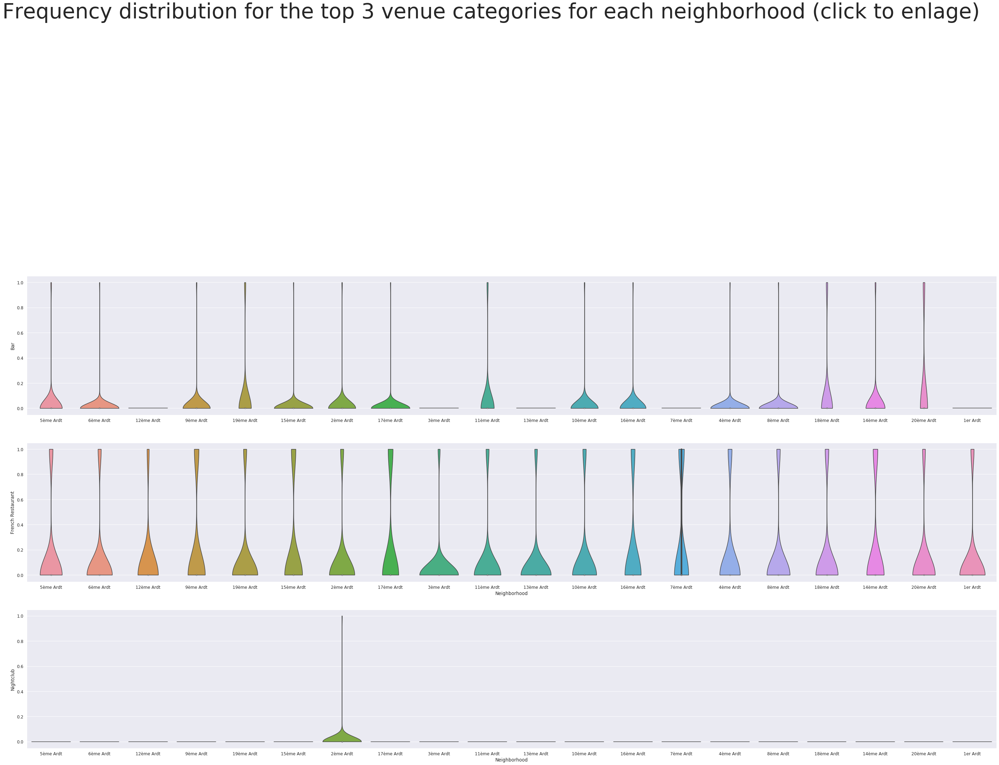

In [30]:
# Categorical plot
# Explore a plot of this data (a violin plot is used which is a density estimation of the underlying distribution).
# The top 3 venue types as specified by the client for each neighborhood are used for the plotting.

import seaborn as sns

fig = plt.figure(figsize=(50,25))
sns.set(font_scale=1.1)

ax = plt.subplot(3,1,1)
sns.violinplot(x="Neighborhood", y="Bar", data=paris_onehot, cut=0);
plt.xlabel("")

plt.subplot(3,1,2)
sns.violinplot(x="Neighborhood", y="French Restaurant", data=paris_onehot, cut=0);

plt.subplot(3,1,3)
sns.violinplot(x="Neighborhood", y="Nightclub", data=paris_onehot, cut=0);

ax.text(-1.0, 3.1, 'Frequency distribution for the top 3 venue categories for each neighborhood (click to enlage)', fontsize=60)
plt.savefig ("Distribution_Frequency_Venues_3_categories.png", dpi=240)
plt.show()

based on the frequency of categories selected by the customer, we can see that 2nd and 11th arrondissement are the best one for a nightlife trip.

##### A person interested into art trip:  
we will select categories 'Art Museum', 'Cultural Center' and 'Pedestrian Plaza'.

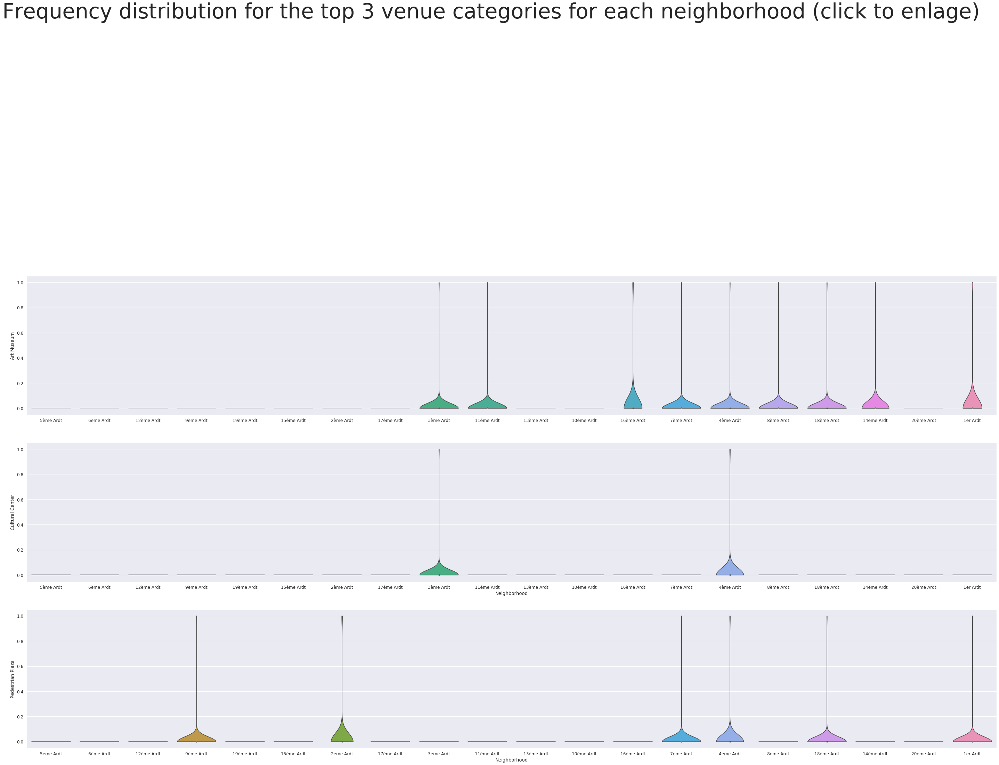

In [31]:
fig = plt.figure(figsize=(50,25))
sns.set(font_scale=1.1)

ax = plt.subplot(3,1,1)
sns.violinplot(x="Neighborhood", y="Art Museum", data=paris_onehot, cut=0);
plt.xlabel("")

plt.subplot(3,1,2)
sns.violinplot(x="Neighborhood", y="Cultural Center", data=paris_onehot, cut=0);

plt.subplot(3,1,3)
sns.violinplot(x="Neighborhood", y="Pedestrian Plaza", data=paris_onehot, cut=0);

ax.text(-1.0, 3.1, 'Frequency distribution for the top 3 venue categories for each neighborhood (click to enlage)', fontsize=60)
plt.savefig ("Distribution_Frequency_Venues_3_categories.png", dpi=240)
plt.show()

based on the frequency of categories selected by the customer, we can see that 4th arrondissement is the best one for a art focus trip.

After choosing a neighborhoods, we can apply k-means clustering to check if other neighborhoods are similar to the one chosen.

In [32]:
num_clusters = 5

X = paris_grouped.drop('Neighborhood', 1)

kmeans = KMeans(init = "k-means++", n_clusters = num_clusters, n_init = 12)
kmeans.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=12, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [33]:
# add clustering labels
paris_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

paris_merged = paris_venues

# merge labels and data about venues to district data and latitude plus longitude data to have all in one dataframe
paris_merged = paris_merged.join(paris_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

paris_merged.head()

,Neighborhood,Latitude,Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,5ème Ardt,48.844443,2.350715,Au P'tit Grec,48.842858,2.349721,Creperie,0,French Restaurant,Bakery,Italian Restaurant,Plaza,Indie Movie Theater,Bar,Museum,Japanese Restaurant,Hotel,Coffee Shop
1,5ème Ardt,48.844443,2.350715,Brewberry Bar,48.842945,2.348622,Bar,0,French Restaurant,Bakery,Italian Restaurant,Plaza,Indie Movie Theater,Bar,Museum,Japanese Restaurant,Hotel,Coffee Shop
2,5ème Ardt,48.844443,2.350715,Place de la Contrescarpe,48.844453,2.349398,Plaza,0,French Restaurant,Bakery,Italian Restaurant,Plaza,Indie Movie Theater,Bar,Museum,Japanese Restaurant,Hotel,Coffee Shop
3,5ème Ardt,48.844443,2.350715,Le Resto,48.843966,2.348117,French Restaurant,0,French Restaurant,Bakery,Italian Restaurant,Plaza,Indie Movie Theater,Bar,Museum,Japanese Restaurant,Hotel,Coffee Shop
4,5ème Ardt,48.844443,2.350715,La Grange,48.842618,2.349701,French Restaurant,0,French Restaurant,Bakery,Italian Restaurant,Plaza,Indie Movie Theater,Bar,Museum,Japanese Restaurant,Hotel,Coffee Shop


In [34]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)

# set color scheme for the clusters
indian_red = '#CD5C5C'
blue = '#2980B9'
purple = '#5B2C6F'
gold = '#F1C40F'
green = '#239B56'
x = np.arange(num_clusters)
rainbow = [indian_red, blue, purple, gold, green]
# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(paris_merged['Latitude'], paris_merged['Longitude'], paris_merged['Neighborhood'], paris_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

<p align="center">
  <img width="460" height="300" src="https://raw.githubusercontent.com/Aymen-lng/Coursera_Capstone/master/Capture%20d’écran%202020-05-25%20à%2022.57.04.png">
</p>



In [36]:

# first: lets examine the green cluster (number zero)
cluster0 = paris_merged.loc[paris_merged['Cluster Labels'] == 0, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]
cluster0['1st Most Common Venue'].value_counts()

French Restaurant    500
Hotel                200
Art Gallery          100
Name: 1st Most Common Venue, dtype: int64

In [37]:

# next: lets examine the indian red cluster (number one)
cluster1 = paris_merged.loc[paris_merged['Cluster Labels'] == 1, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]
cluster1['1st Most Common Venue'].value_counts()

Vietnamese Restaurant    100
Name: 1st Most Common Venue, dtype: int64

In [38]:

# next: lets examine the blue cluster (number two)
cluster2 = paris_merged.loc[paris_merged['Cluster Labels'] == 2, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]
cluster2['1st Most Common Venue'].value_counts()

French Restaurant    557
Name: 1st Most Common Venue, dtype: int64

In [39]:

# Now Lets examine the purple cluster (number three)
cluster3 = paris_merged.loc[paris_merged['Cluster Labels'] == 3, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]
cluster3['1st Most Common Venue'].value_counts()

Lake    22
Name: 1st Most Common Venue, dtype: int64

In [40]:
# Now lets examine the yellow cluster (number four)
cluster4 = paris_merged.loc[paris_merged['Cluster Labels'] == 4, paris_merged.columns[[1] + list(range(5, paris_merged.shape[1]))]]
cluster4['1st Most Common Venue'].value_counts()

French Restaurant    300
Bar                   55
Name: 1st Most Common Venue, dtype: int64

The last step is just mapping Paris with all Airbnb geolocated.

In [41]:
pip install geopandas

     |████████████████████████████████| 931kB 6.7MB/s eta 0:00:01
     |████████████████████████████████| 1.8MB 23.9MB/s eta 0:00:01
     |████████████████████████████████| 14.7MB 5.0MB/s eta 0:00:011�██████                    | 5.5MB 33.9MB/s eta 0:00:01     |█████████████████████████████▋  | 13.6MB 5.0MB/s eta 0:00:01
     |████████████████████████████████| 10.9MB 3.2MB/s eta 0:00:01
     |████████████████████████████████| 92kB 5.9MB/s  eta 0:00:01
  Found existing installation: pyproj 1.9.6
    Uninstalling pyproj-1.9.6:
      Successfully uninstalled pyproj-1.9.6
Note: you may need to restart the kernel to use updated packages.


In [42]:
import pandas as pd
import geopandas as gpd

In [43]:
from shapely.geometry import Point, shape

locs_geometry = [Point(xy) for xy in zip(listing.longitude,
                                         listing.latitude)]
crs = {'init': 'epsg:4326'}
# Coordinate Reference Systems, "epsg:4326" is a common projection of WGS84 Latitude/Longitude
locs_gdf = gpd.GeoDataFrame(listing, crs=crs, geometry=locs_geometry)

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [44]:
from folium import plugins

cluster_map = folium.Map(location=[paris.loc[9,'Latitude'],paris.loc[(9),'Longitude']],
                         zoom_start=15, tiles='cartodbpositron')

marker_cluster = plugins.MarkerCluster().add_to(cluster_map)
indian_red = '#CD5C5C'
blue = '#2980B9'
purple = '#5B2C6F'
gold = '#F1C40F'
green = '#239B56'
x = np.arange(num_clusters)
rainbow = [indian_red, blue, purple, gold, green]
# add markers to the map
markers_colors = []

       
for i, v in locs_gdf.iterrows():
    popup = """
    Location id : <b>%s</b><br>
    Room type : <b>%s</b><br>
    Neighbourhood : <b>%s</b><br>
    Price : <b>%d</b><br>
    """ % (v['id'], v['room_type'], v['neighbourhood'] , v['price'])
    
    if v['room_type'] == 'Entire home/apt':
        folium.CircleMarker(location=[v['latitude'], v['longitude']],
                            radius=3,
                            tooltip=popup,
                            color='#FFBA00',
                            fill_color='#FFBA00',
                            fill=True).add_to(marker_cluster)
    elif v['room_type'] == 'Private room':
        folium.CircleMarker(location=[v['latitude'], v['longitude']],
                            radius=3,
                            tooltip=popup,
                            color='#087FBF',
                            fill_color='#087FBF',
                            fill=True).add_to(marker_cluster)
    elif v['room_type'] == 'Shared room':
        folium.CircleMarker(location=[v['latitude'], v['longitude']],
                            radius=3,
                            tooltip=popup,
                            color='#FF0700',
                            fill_color='#FF0700',
                            fill=True).add_to(marker_cluster)

In [45]:
cluster_map

<p align="center">
  <img width="460" height="300" src="https://raw.githubusercontent.com/Aymen-lng/Coursera_Capstone/master/Capture%20d’écran%202020-05-26%20à%2015.30.23.png">
</p>




### Step 4: Results

#### Results analysis:

Using a center latitude and longitude might not be the best way of mapping Paris neighborhoods. In fact, center neighborhoods (1/2/3/4/5/6) are small and this kind of mapping can be interesting. For external ones (12/13/14/15/16/17/18/19/20), as they are bigger, the center might not represent a good sample of venues that can be find in the whole neighborhood. 
Furthermore, if we have a look on neighborhood 12 and 16, both borders a wood that is include in the neighborhood. The consequence is a move of the center (as the woods are as big as the whole neighborhood).
The problem occurs on the foursquare request. One of the parameters is a radius around the center of Neighborhood to analyze the venues. If the neighborhood is too big and the radius not enough, shall we consider the venues analyzed as representative of the neighborhood?
I started with a radius of 500m and didn’t had enough venues. But with 1000, the results look much better.


Foursquare provides a great and complete database of Paris venues. One of the parameters is a radius to apply on each neighborhood latitude and longitude.  The same potential problem can happen here, maybe another way to set up the perimeter to analyze must be find.
There is also another point regarding the result of foursquare request. The venues categories are highly detailed, which is good for an analytical purpose. But in our case, we want to stereotype neighborhoods in order to help customer making a choice based on a trip stereotype. So, the more generic categories we have, the best it is.  
223 unique categories look too much to have generic enough categories, and as explained in the notebook, some distinctions are nor relevant. 


By experience when we check the mapping of K-means clusters, the result looks interesting and realistic.  
Every person who knows well Paris, could agree that neighborhoods highlighted in the map are similar enough to be on the same clusters.
K-means looks like a great model to cluster a city like Paris.
When we check the result of clustering in details, with top categories.
We just find the same limits highlighted upper.
Clusters Purple and Yellow has a unique top category as they cover a big neighborhood, and maybe the radius applied is not big enough to integrate enough categories.
It is totally right to consider Vietnamese restaurant as a top category in neighborhood “13eme arrondissement” also known as the “Parisian China town” (more Vietnamese than Chinese), but it could be great to integrate a larger analysis in this cluster.



#### Comments and improvements on results:

When doing al the steps of methodology, I already implicitly highlighted some improvement points. 
First, the mapping of Paris can be improved by applying a perimeter parameter instead of centralized point. In the same source of data, it is possible to select a database with multi polygon data that would allow mapping all the city by highlighting the real perimeter of each “arrondissement”.
If his perimeter data can also be applied in Foursquare requests instead of a radius, then we are 100% sure that a large variety of venues will train our model. 
Talking about the model, finally a good improvement could be working on the categories of venues, and find a way to create groups of categories, like grouping all restaurant that are not “French Restaurant” as “Other type of Restaurant” or also grouping all sports activity into a unique category “sport” etc.


### Step 5: Conclusion

Mean, and K-mean is a great way to create tools to help a customer to cluster and get more information about different neighborhoods of a city.
Foursquare provide a good database of different venues in the city. The details and volume of information allow the model getting trained well. 
The first set, mean analysis, allows checking all neighborhoods and the probability distribution of venues category,
Then, K-mean clustering allows mapping different cluster of similar neighborhoods to be able making a choice on which area the customer is interested in,
The toll can be improved with more analysis on categories of venues obtain by the foursquare request, and by applying an analysis of neighborhood using multi polygon data.
